In [1]:
import os
from tqdm.notebook import tqdm

import matplotlib.pyplot as plt

import numpy as np

from amygdala_spiking.data import load_bids_subject, epoch_sig
from amygdala_spiking.preproc import preprocess

from neurodsp.spectral import compute_spectrum
from neurodsp.utils.norm import normalize_variance
from neurodsp.plts import plot_time_series, plot_power_spectra

from fooof import FOOOFGroup, FOOOF

In [2]:
# Load bids data
bids_dir = os.path.join(os.getcwd(), 'data_bids')
raw = load_bids_subject('01', bids_dir)

# Extract data from MNE raw object
sigs, times = raw.get_data(return_times=True)

# Channel keys and epoched sig values
sigs_ch = {ch_name:epoch_sig(sig) for sig, ch_name in zip(sigs, raw.ch_names)}

fs = raw.info['sfreq']
epoch_types = raw.annotations.description

sub_dict = {'sigs': sigs_ch, 'epoch_types': epoch_types, 'times': times, 'fs': fs}

Extracting parameters from /home/voytek/projects/amygdala_spiking/data_bids/sub-01/ses-01/ieeg/sub-01_ses-01_task-jokeit_run-01_ieeg.vhdr...
Setting channel info structure...
Reading events from /home/voytek/projects/amygdala_spiking/data_bids/sub-01/ses-01/ieeg/sub-01_ses-01_task-jokeit_run-01_events.tsv.
Reading channel info from /home/voytek/projects/amygdala_spiking/data_bids/sub-01/ses-01/ieeg/sub-01_ses-01_task-jokeit_run-01_channels.tsv.
Reading electrode coords from /home/voytek/projects/amygdala_spiking/data_bids/sub-01/ses-01/ieeg/sub-01_ses-01_space-MNI152_electrodes.tsv.


In [3]:
# Bandpass filter
preproc_dict = preprocess(sub_dict, pass_type='lowpass', f_range=500)

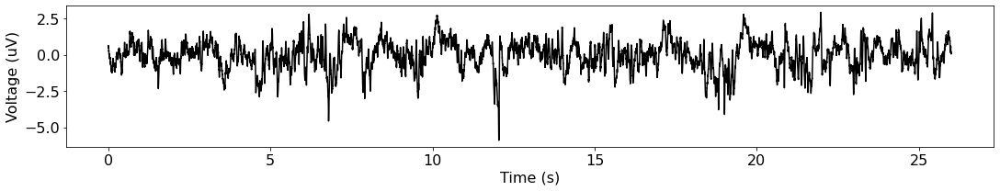

In [4]:
sigs = preproc_dict['sigs']['mmAL1']

sig = normalize_variance(sigs[0], variance=1)

times = np.arange(0, len(sig)/fs, 1/fs)

plot_time_series(times, sig)


FOOOF WARNING: Skipping frequency == 0, as this causes a problem with fitting.


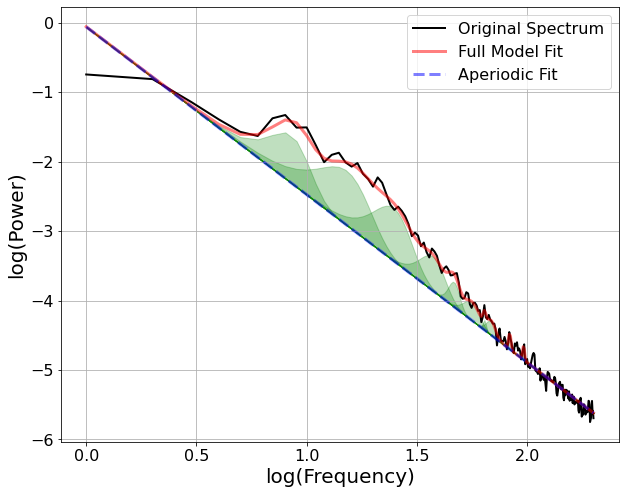

In [34]:
freqs, powers = compute_spectrum(sig, fs, f_range=(0, 200))

fm = FOOOF(peak_width_limits=(2, 10), )

fm.fit(freqs, powers)

fm.plot(plot_peaks='shade', plt_log=True)

In [35]:
import emd

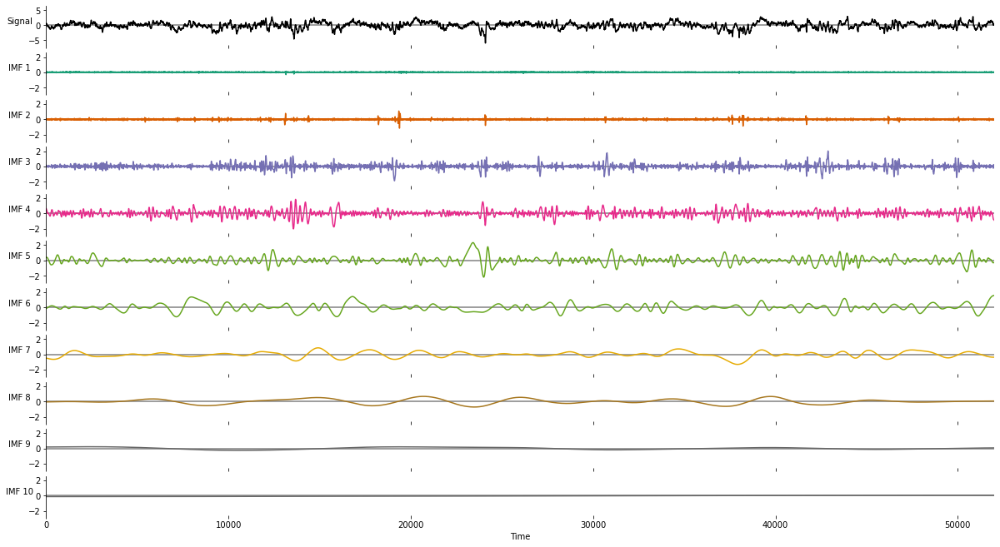

In [36]:
imf = emd.sift.sift(sig)

fig = plt.figure(figsize=(20, 10))

emd.plotting.plot_imfs(imf, cmap=True, scale_y=True, fig=fig)

In [37]:
freqs_imf, powers_imf = compute_spectrum(imf.T, fs, f_range=(0, 200))

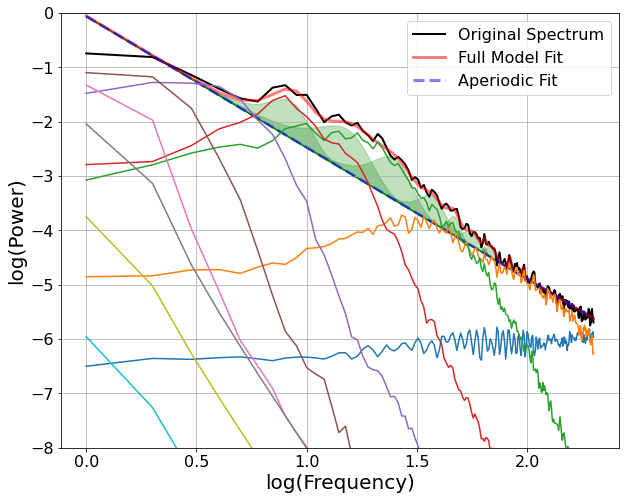

In [99]:
#labels = ['imf_' + str(i+1) for i in range(len(powers_imf))]
#labels.insert(0, 'orig')

fm.plot(plot_peaks='shade', plt_log=True)

ax = plt.gca()

for power_imf in powers_imf:
    plt.plot(np.log10(freqs_imf[1:]), np.log10(power_imf[1:]))
    
ax.set_ylim(-8, 0)

plt.show()

In [189]:
imf_t = imf.T

power_over_ap = np.zeros(len(powers_imf))
    
for ind, power_imf in enumerate(powers_imf):
    
    diff = np.log10(power_imf[1:]) - fm._ap_fit
    inds = np.where(diff > 0)[0]
    
    if len(inds) != 0:
        
        power_over_ap[ind] = np.mean(diff[inds])

# Threshold
power_thresh = 0.2

pe_mask = power_over_ap > power_thresh

pe_modes = imf_t[pe_mask]
ap_modes = imf_t[~pe_mask]

sig_pe = pe_modes.sum(axis=0)
sig_ap = ap_modes.sum(axis=0)

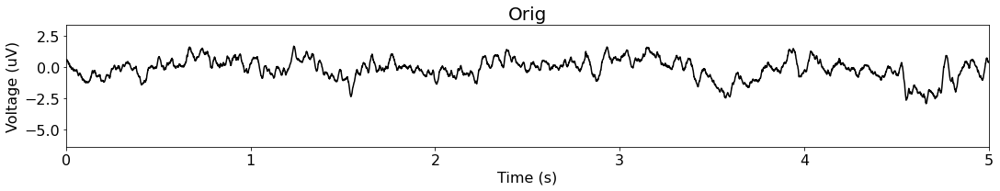

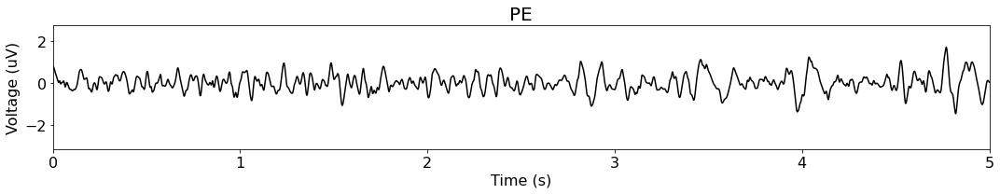

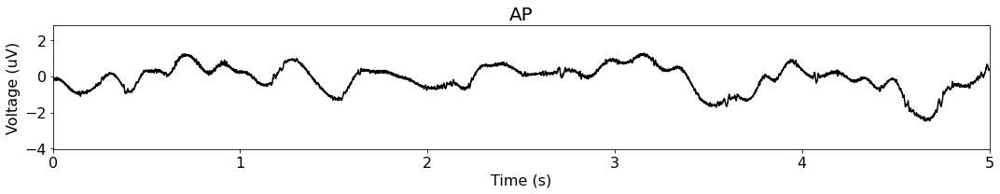

In [213]:
xlim = (0, 5)

plot_time_series(times, sig, title='Orig', xlim=xlim)
plot_time_series(times, sig_pe, title='PE', xlim=xlim)
plot_time_series(times, sig_ap, title='AP', xlim=xlim)

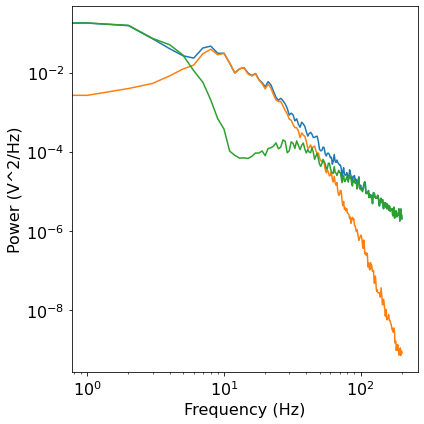

In [212]:
f_orig, p_orig = compute_spectrum(sig, fs, f_range=(0, 200))
f_pe, p_pe = compute_spectrum(sig_pe, fs, f_range=(0, 200))
f_ap, p_ap = compute_spectrum(sig_ap, fs, f_range=(0, 200))

plot_power_spectra(f_orig, [p_orig, p_pe, p_ap])

In [341]:
from scipy.optimize import curve_fit
from fooof.core.funcs import gaussian_function

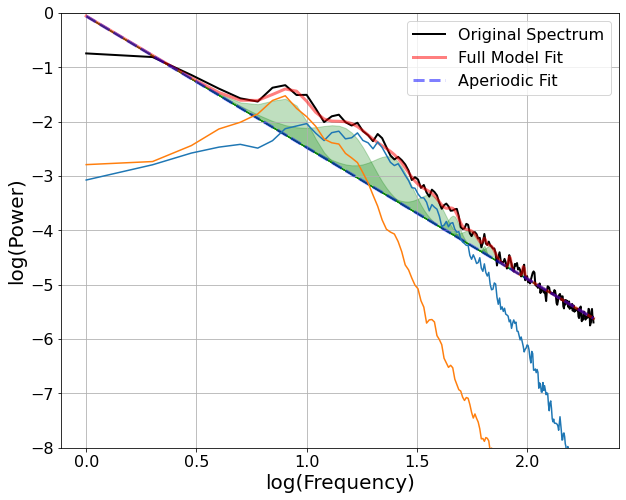

In [443]:
fm.plot(plot_peaks='shade', plt_log=True)

ax = plt.gca()

for power_imf in powers_imf[[2, 3]]:
    plt.plot(np.log10(freqs_imf[1:]), np.log10(power_imf[1:]))
    
ax.set_ylim(-8, 0)

plt.show()

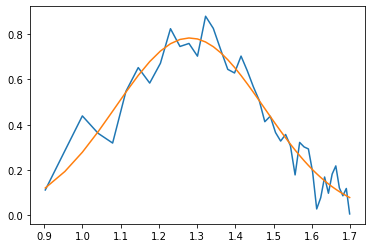

In [468]:
#
ap_rm = np.log10(powers_imf[2, 1:]) - fm._ap_fit
#ap_rm = np.log10(fm.power_spectrum) - fm._ap_fit
inds = np.where(ap_rm >= 0)[0]

#
xs = np.log10(fm.freqs)[inds]
#ys = 10**fm.power_spectrum[inds]
ys = ap_rm[inds]

params, _ = curve_fit(gaussian_function, xs, ys, p0=[.5, 1, .5])

gauss_fit = gaussian_function(xs, *params)
plt.plot(xs, ys)
plt.plot(xs, gauss_fit)

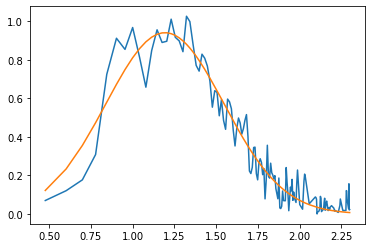

In [457]:
#
#ap_rm = np.log10(powers_imf[3, 1:]) - fm._ap_fit
ap_rm = fm.power_spectrum - fm._ap_fit
inds_b = np.where(ap_rm >= 0)[0]

#
xs = np.log10(fm.freqs)[inds_b]
ys = ap_rm[inds_b]

params, _ = curve_fit(gaussian_function, xs, ys, p0=[.25, .5, .5])

gauss_fit_b = gaussian_function(xs, *params)
plt.plot(xs, ys)
plt.plot(xs, gauss_fit_b)

In [448]:
ap_fit = fm._ap_fit

pe_fit_a = ap_fit.copy()
pe_fit_b = ap_fit.copy()

zeros = np.zeros(len(pe_fit_a), dtype='bool')
zeros[inds] = 1
pe_fit_a[~zeros] = np.nan

zeros = np.zeros(len(pe_fit_b), dtype='bool')
zeros[inds_b] = 1
pe_fit_b[~zeros] = np.nan

pe_fit_a[inds] += gauss_fit
pe_fit_b[inds_b] += gauss_fit_b

#pe_fit_a[~inds] = np.nan
#pe_fit_b[~inds] = np.nan

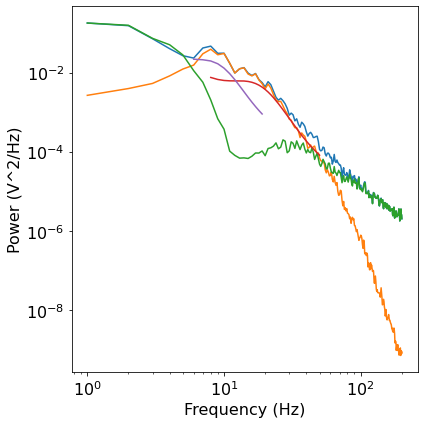

In [450]:
plot_power_spectra(f_orig[1:], [p_orig[1:], p_pe[1:], p_ap[1:], 10 ** pe_fit_a, 10 ** pe_fit_b])

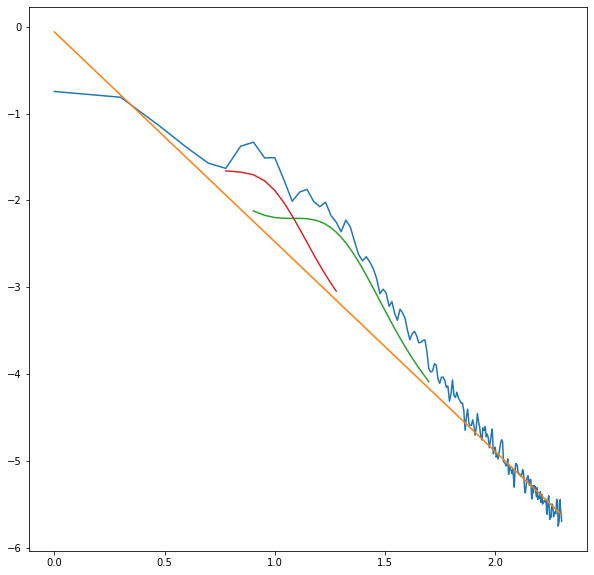

In [441]:
#labels = ['imf_' + str(i+1) for i in range(len(powers_imf))]
#labels.insert(0, 'orig')

#fm.plot(plt_log=True)

#ax = plt.gca()
fig = plt.figure(figsize=(10, 10))

plt.plot(np.log10(freqs_imf[1:]), fm.power_spectrum)
plt.plot(np.log10(freqs_imf[1:]), fm._ap_fit)

#for power_imf in powers_imf[[2, 3]]:
#    plt.plot(np.log10(freqs_imf[1:]), np.log10(power_imf[1:]))
    
ax.set_ylim(-8, 0)

plt.plot(np.log10(freqs_imf[1:]), pe_fit_a)
plt.plot(np.log10(freqs_imf[1:]), pe_fit_b)
plt.show()

In [274]:
from ndspflow.motif import Motif

mtf = Motif(
    corr_thresh=0.5,
    var_thresh=0.0,
    min_clust_score=0.25,
    min_clusters=1,
    max_clusters=5,
    min_n_cycles=10,
    center='peak',
    random_state=None
)

mtf.fit(fm, sig_pe, fs)

In [205]:
mtf.plot(plot_sig=False)

In [208]:
from ndspflow.motif import Motif

mtf = Motif(
    corr_thresh=0.5,
    var_thresh=0.0,
    min_clust_score=0.25,
    min_clusters=1,
    max_clusters=5,
    min_n_cycles=10,
    center='peak',
    random_state=None
)

mtf.fit(fm, sig_ap, fs)

mtf.plot(plot_sig=False)